<a href="https://colab.research.google.com/github/oguzcanbekar/Lambertian-sphere/blob/main/Copy_of_YOLOv7Detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import sys
import torch
import glob
print(f"Python version: {sys.version}, {sys.version_info} ")
print(f"Pytorch version: {torch.__version__} ")

Python version: 3.9.16 (main, Dec  7 2022, 01:11:51) 
[GCC 9.4.0], sys.version_info(major=3, minor=9, micro=16, releaselevel='final', serial=0) 
Pytorch version: 1.13.1+cu116 


In [2]:
!nvidia-smi

NVIDIA-SMI has failed because it couldn't communicate with the NVIDIA driver. Make sure that the latest NVIDIA driver is installed and running.



In [ ]:
!# Download YOLOv7 code
!git clone https://github.com/WongKinYiu/yolov7
%cd yolov7
!pip install -r requirements.txt
!ls

In [ ]:
!# Download trained weights
!wget https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7.pt

In [5]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
!unzip /content/gdrive/MyDrive/CrowdHuman_train01.zip -d /content/train_images/
!unzip /content/gdrive/MyDrive/CrowdHuman_train02.zip -d /content/train_images/
!unzip /content/gdrive/MyDrive/CrowdHuman_train03.zip -d /content/train_images/



In [ ]:
!unzip /content/gdrive/MyDrive/CrowdHuman_val.zip -d /content/val_images/

In [40]:
train_images = sorted(glob.glob("/content/train_images/images/*.jpg"))
print(len(train_images))

15000


In [45]:
val_images = sorted(glob.glob("/content/val_images/images/*.jpg"))
print(len(val_images))

4370


In [43]:
# UPDATE ANNOTATION FILE
import json
import numpy as np

with open('/content/gdrive/MyDrive/annotation_train.odgt', 'r+') as f:
    datalist = f.readlines()
    
inputfile = []
inner = {}
for i in np.arange(len(datalist)):
    adata = json.loads(datalist[i])
    gtboxes = adata['gtboxes']
    for gtbox in gtboxes:
      # print(gtbox) Checking annotation examples
      # print(adata['ID'])
        if gtbox['tag']=='person':
            inner = {
                    'filename': adata['ID'],
                    'name': 'person_head',
                    'headbox': gtbox['hbox']
                }
            inputfile.append(inner)
    
inputfile = json.dumps(inputfile)

with open('/content/train_images/annotation_train.json', 'a+') as f:
    f.write(str(inputfile))

<ipython-input-9-a2f7b05db879>:3: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  example_img1 = io.imread("/content/train_images/Images/273271,1017c000ac1360b7.jpg")


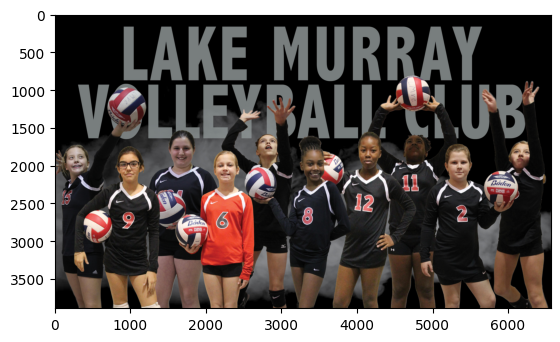

In [9]:
import matplotlib.pyplot as plt
import imageio as io
example_img1 = io.imread("/content/train_images/Images/273271,1017c000ac1360b7.jpg")
plt.imshow(example_img1)
plt.show()
io.imwrite('/content/example1.jpg', example_img1)

In [10]:
# Opening JSON file
f = open('/content/train_images/annotation_train.json')
  
# returns JSON object as a dictionary
datas = json.load(f)
headboxes = []
# Iterating through the json list
for data in datas:
    if data['filename'] == '273271,1017c000ac1360b7':
      
      print(data['headbox'])
      headboxes.append(data['headbox'])
  
# Closing file
f.close()

[113, 1731, 362, 399]
[810, 1749, 373, 489]
[1497, 1534, 368, 505]
[2099, 1804, 362, 431]
[2654, 1588, 319, 314]
[3235, 1718, 340, 500]
[4009, 1561, 321, 499]
[4601, 1599, 348, 326]
[5148, 1716, 378, 489]
[6005, 1674, 339, 365]


113 1731 362 399
810 1749 373 489
1497 1534 368 505
2099 1804 362 431
2654 1588 319 314
3235 1718 340 500
4009 1561 321 499
4601 1599 348 326
5148 1716 378 489
6005 1674 339 365


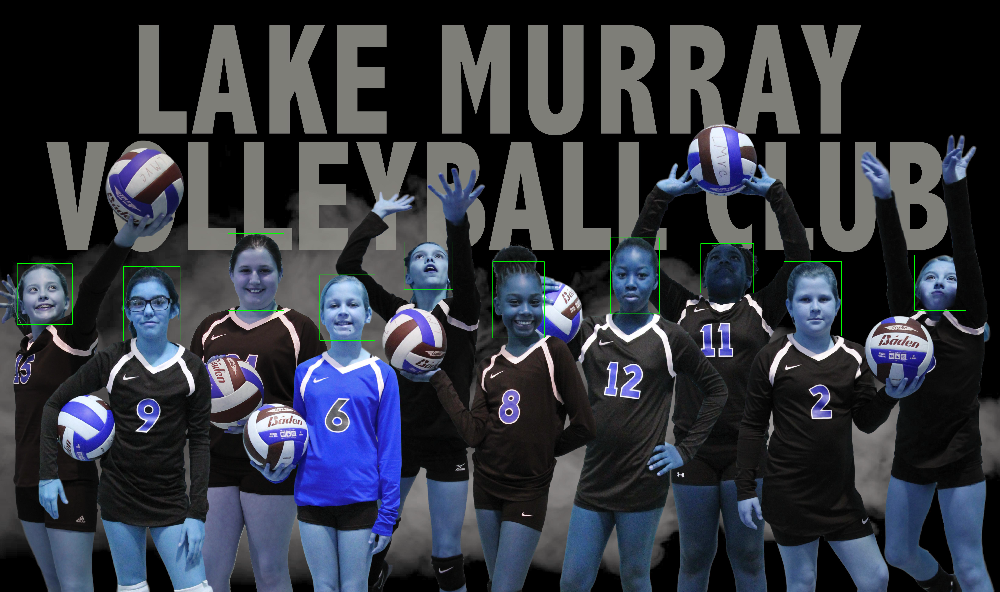

In [11]:
import cv2
from google.colab.patches import cv2_imshow

for box in headboxes:
  x0 = box[0]
  y0 = box[1]
  x1 = box[2]
  y1 = box[3]
  print(x0, y0, x1, y1)

  cv2.rectangle(example_img1, (x0, y0), (x0+x1, y0+y1), color=(0,255,0), thickness=2)

cv2_imshow(example_img1)

**Prepare The Labels**

In [29]:
def make_dir_ignore(path):
    try:
        os.makedirs(path)
    except:
        print("")

def image_shape(ID, image_dir):
    assert image_dir is not None
    jpg_path = image_dir / ('%s.jpg' % ID)
    #print(jpg_path)
    img = cv2.imread(jpg_path.as_posix())
    return img.shape

def txt_line(cls, bbox, img_w, img_h):
    """Generate 1 line in the txt file."""
    x, y, w, h = bbox
    x = max(int(x), 0)
    y = max(int(y), 0)
    w = min(int(w), img_w - x)
    h = min(int(h), img_h - y)

    cx = (x + w / 2.) / img_w
    cy = (y + h / 2.) / img_h
    nw = float(w) / img_w
    nh = float(h) / img_h
    return '%d %.6f %.6f %.6f %.6f\n' % (cls, cx, cy, nw, nh)

def process(set_='val', annotation_filename='annotation_val.odgt',
            output_dir='/content/train_images/'):
    """Process either 'train' or 'test' set."""
    assert output_dir is not None
    # output_dir.mkdir(exist_ok=True)
    jpgs = []
    # make_dir_ignore(output_dir / "labels" / set_)
    
    with open(annotation_filename, 'r') as fanno:
        for raw_anno in fanno.readlines():
            anno = json.loads(raw_anno)
            ID = anno['ID']  # e.g. '273271,c9db000d5146c15'
            print('Processing ID: %s' % ID)
            img_h, img_w, img_c = image_shape(ID, output_dir / Path("images"))
            assert img_c == 3  # should be a BGR image
            txt_path = output_dir / Path("labels") / ('%s.txt' % ID)
            # print(txt_path) 
            # write a txt for each image
            with open(txt_path.as_posix(), 'w') as ftxt:
                for obj in anno['gtboxes']:
                    if obj['tag'] == 'mask':
                        continue  # ignore non-human
                    assert obj['tag'] == 'person'
                    if 'hbox' in obj.keys():  # head
                        line = txt_line(1, obj['hbox'], img_w, img_h)
                        # print(line) " Information of each head bounding box for each image "
                        if line:
                          ftxt.write(line)
                    #if 'fbox' in obj.keys():  # full body
                    #    line = txt_line(0, obj['fbox'], img_w, img_h)
                    #    if line:
                    #        ftxt.write(line)
            jpgs.append('%s/%s.jpg' % (output_dir / Path("images") / Path(set_), ID))
    print(jpgs)


In [ ]:
process(set_='train', annotation_filename='/content/gdrive/MyDrive/annotation_train.odgt')

In [ ]:
process(set_='val', annotation_filename='/content/gdrive/MyDrive/annotation_val.odgt', output_dir='/content/val_images/')

In [46]:
val_images = sorted(glob.glob("/content/val_images/images/*.jpg"))
val_labels = sorted(glob.glob("/content/val_images/labels/*.txt"))

In [47]:
print(val_images[124])
print(val_labels[124])

/content/val_images/images/273271,2f11d000b2496dd0.jpg
/content/val_images/labels/273271,2f11d000b2496dd0.txt


Move Train and Val Folders to Yolov7 data Folder

In [49]:
!mv  /content/train_images /content/yolov7/data

In [50]:
!mv  /content/val_images /content/yolov7/data

In [13]:
!# Detection
!python detect.py --weights yolov7.pt --conf 0.25 --img-size 640 --source /content/train_images/Images/273271,1017c000ac1360b7.jpg

Namespace(weights=['yolov7.pt'], source='/content/train_images/Images/273271,1017c000ac1360b7.jpg', img_size=640, conf_thres=0.25, iou_thres=0.45, device='', view_img=False, save_txt=False, save_conf=False, nosave=False, classes=None, agnostic_nms=False, augment=False, update=False, project='runs/detect', name='exp', exist_ok=False, no_trace=False)
YOLOR 🚀 v0.1-122-g3b41c2c torch 1.13.1+cu116 CPU

Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
Model Summary: 306 layers, 36905341 parameters, 6652669 gradients
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

/usr/local/lib/python3.9/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
9 persons, 8 sports balls, Done. (1546.7m

In [14]:
# define helper functions to show images
def imShow(path):
  import cv2
  import matplotlib.pyplot as plt
  %matplotlib inline

  image = cv2.imread(path)
  height, width = image.shape[:2]
  resized_image = cv2.resize(image,(3*width, 3*height), interpolation = cv2.INTER_CUBIC)

  fig = plt.gcf()
  fig.set_size_inches(50, 40)
  plt.axis("off")
  plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
  plt.show()

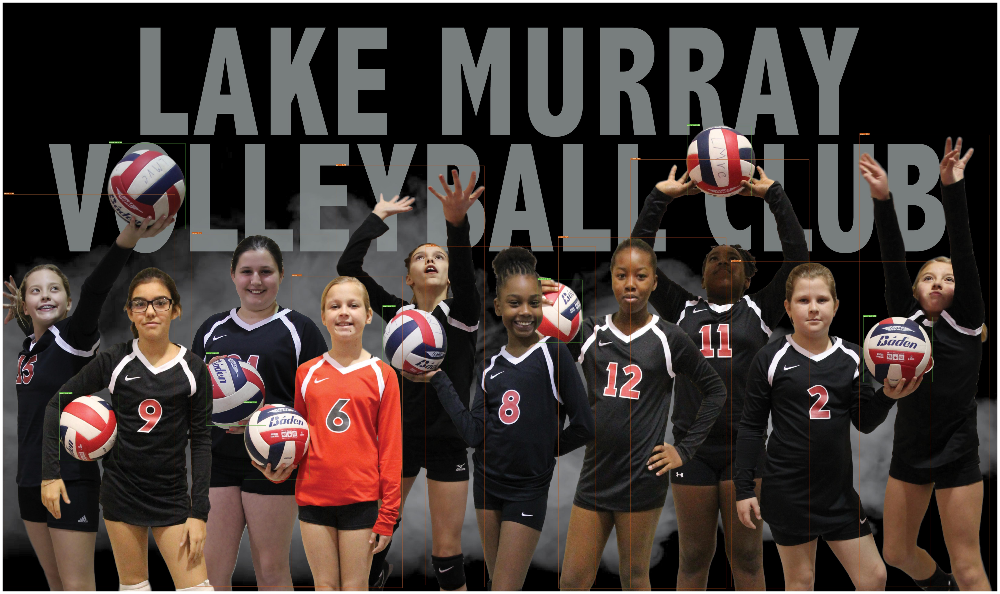

In [15]:
imShow("runs/detect/exp/273271,1017c000ac1360b7.jpg")